# <b>  Hotel Booking Demand Dataset

Notebook by: Luqman Hanif bin Mokhtar (https://www.linkedin.com/in/luqmanhanifmokhtar/)

<a name='home'> </a>
### Menu

1. [Overview](#overview)
2. [Import Resources & Load Dataset](#irld)
3. [Exploratory Data Analysis & Data Preprocessing](#edaprep)
4. [Booking Cancellation Prediction](#predcel)
5. [Nights Booked Predictor](#predbook)
6. [Wrap-up](#wrap)

NOTE for Pre-Interview Exercise:<br> 
Q1 is answered under EDA, Q2 & Q3 is done under the Wrap-up/Conclusion, and Q4 & Q5 is done under the modelling section and concluded in the Wrap-up.

***********

<a name='overview'> </a>
## <b> Overview


The dataset used in this case study was sourced from the following link: <br>
https://www.sciencedirect.com/science/article/pii/S2352340918315191 <br>
<br>
Termionologies and descriptions are also provided in the paper. <br>
<br>
This notebook will cover an exploratory data analysis to capture insights/trends, as well as to develop two distinct models: <br>
(1) Booking Cancellations Prediction (PredCel), and <br>
(2) Number of Nights Booked Prediction (PredBook). <br>
<br>
<br>


**************

<a name='irld'> </a>
## <b> Import Resources & Load Dataset

In [1]:
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import dates
%matplotlib inline

import chart_studio.plotly as py
import plotly.express as px
import plotly.graph_objects as go

import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot 
init_notebook_mode (connected=True)
cf.go_offline()

In [2]:
url='https://drive.google.com/file/d/1jecJaZfY7nvDFuIn9YKU6Iw61iB-pqlO/view?usp=sharing'
url2='https://drive.google.com/uc?id=' + url.split('/')[-2]
df = pd.read_csv(url2)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

In [3]:
df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


[Home](#home)

**********

<a name='edaprep'> </a>
## <b> Exploratory Data Analysis & Data Preprocessing

### Quick Glance

In [4]:
from pandas_profiling import ProfileReport

In [5]:
profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/46 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

From the quick glance on the data through the profilereport, there are a few points that needs to be highlighted/aware of: <br>
(1) Missing values <br>
Missing values must be addressed. Whether to remove or impute. <br>
<br>
(2) Extreme Values <br>
With consideration with the problem and algorithm methodology, extreme values or outliers should be considered to be maintained or removed from the dataset.<br>
<br>
(3) Correlation/Interaction between variables (which is discussed further later) <br>
<br>

Text(0.5, 1.0, "Spearman's Correlation Heatmap")

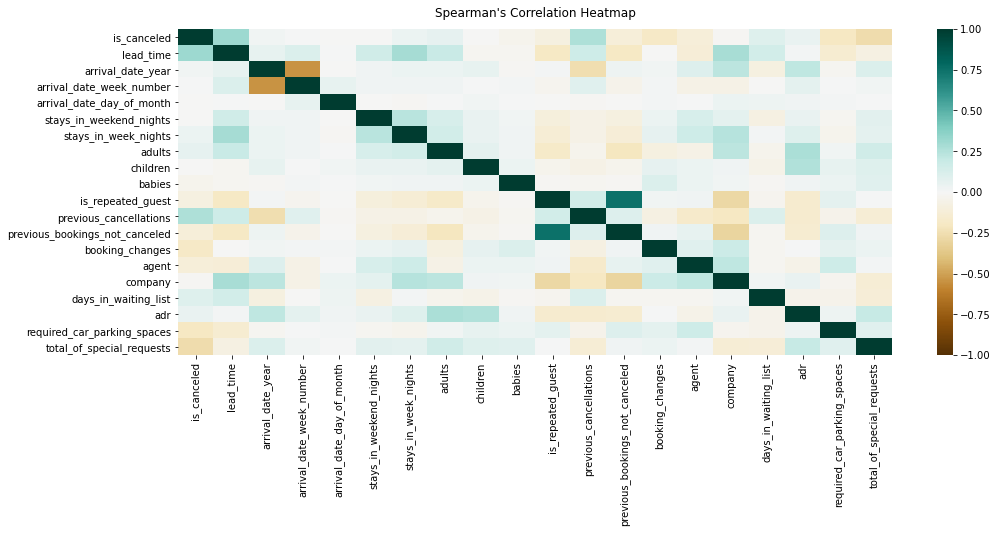

In [6]:
dfcorr = df.corr(method='spearman')

plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(dfcorr, vmin=-1, vmax=1, annot=False, cmap='BrBG')
heatmap.set_title("Spearman's Correlation Heatmap", 
                  fontdict={'fontsize':12}, 
                  pad=12)

Text(0.5, 1.0, "Spearman's Correlation Heatmap")

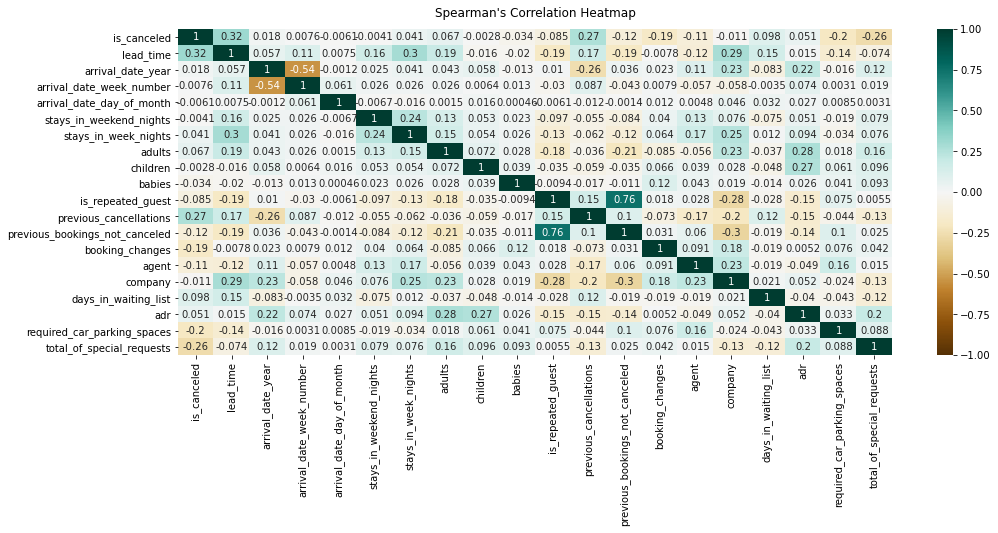

In [7]:
dfcorr = df.corr(method='spearman')

plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(dfcorr, vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title("Spearman's Correlation Heatmap", 
                  fontdict={'fontsize':12}, 
                  pad=12)

From the correlation heatmap(s), several features standout in showcasing reactivity between each other. These features could be useful in finding patterns, predictions, as well as pinpointing collinearity within the independent variables. Note that without encoding the categorical variables (in 'object' dtype), this current heatmap will not display them, another correlation heatmap is shown after encoding is done, later in the notebook. <br>
<br>

******

### Data Preprocessing

Data prep on handling null values, encoding variables, and split dataset according to use case. Feature Selection/importance and outliers handling are placed under the modelling section as each model requires a different approach; classification and regression.

<b> Data Handling (Null/Missing Values)

In [69]:
dfcopy = df.copy()
dfcopy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

In [9]:
dfcopy.isnull().sum()

hotel                                  0
is_canceled                            0
lead_time                              0
arrival_date_year                      0
arrival_date_month                     0
arrival_date_week_number               0
arrival_date_day_of_month              0
stays_in_weekend_nights                0
stays_in_week_nights                   0
adults                                 0
children                               4
babies                                 0
meal                                   0
country                              488
market_segment                         0
distribution_channel                   0
is_repeated_guest                      0
previous_cancellations                 0
previous_bookings_not_canceled         0
reserved_room_type                     0
assigned_room_type                     0
booking_changes                        0
deposit_type                           0
agent                              16340
company         

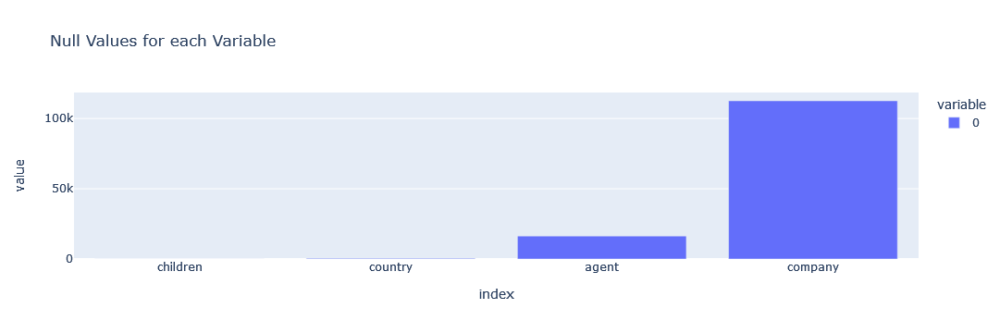

In [14]:
px.bar(dfcopy[['children','country','agent','company']].isnull().sum(), 
       title='Null Values for each Variable')

Replacing null values with values that can be used in the analysis. By default, zero is a reasonable value to placed very continuous variables.

In [70]:
nullreplace = {"children": 0,
               "country": "Unknown", 
               "agent": 0, 
               "company": 0}

dfcopy = dfcopy.fillna(nullreplace)
dfcopy.isnull().sum()

hotel                             0
is_canceled                       0
lead_time                         0
arrival_date_year                 0
arrival_date_month                0
arrival_date_week_number          0
arrival_date_day_of_month         0
stays_in_weekend_nights           0
stays_in_week_nights              0
adults                            0
children                          0
babies                            0
meal                              0
country                           0
market_segment                    0
distribution_channel              0
is_repeated_guest                 0
previous_cancellations            0
previous_bookings_not_canceled    0
reserved_room_type                0
assigned_room_type                0
booking_changes                   0
deposit_type                      0
agent                             0
company                           0
days_in_waiting_list              0
customer_type                     0
adr                         

Removal of no guests, from the previous profile report, for the variables adult, children, and babies, there are values that are zero for all three which indicates no guest, which could indicate a no show.

In [16]:
dfcopy.loc[dfcopy["adults"] +
           dfcopy["children"]+
           dfcopy["babies"] == 0].shape

(180, 32)

There are 180 entries that are with 0 guests. These rows will be dropped.

In [71]:
dfcopy.drop(dfcopy.loc[dfcopy["adults"]+
                       dfcopy["children"]+
                       dfcopy["babies"] == 0].index, inplace=True)

*******

<b>Encode Categorical Variables

In [72]:
encodeddf = dfcopy.copy()

In [19]:
from sklearn.preprocessing import LabelEncoder

In [73]:
object_cols = encodeddf.loc[:, encodeddf.dtypes == np.object]
object_cols.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 119210 entries, 0 to 119389
Data columns (total 12 columns):
 #   Column                   Non-Null Count   Dtype 
---  ------                   --------------   ----- 
 0   hotel                    119210 non-null  object
 1   arrival_date_month       119210 non-null  object
 2   meal                     119210 non-null  object
 3   country                  119210 non-null  object
 4   market_segment           119210 non-null  object
 5   distribution_channel     119210 non-null  object
 6   reserved_room_type       119210 non-null  object
 7   assigned_room_type       119210 non-null  object
 8   deposit_type             119210 non-null  object
 9   customer_type            119210 non-null  object
 10  reservation_status       119210 non-null  object
 11  reservation_status_date  119210 non-null  object
dtypes: object(12)
memory usage: 11.8+ MB


In [74]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

for i in range(0,encodeddf.shape[1]):
    if encodeddf.dtypes[i]=='object':
        encodeddf[encodeddf.columns[i]] = le.fit_transform(encodeddf[encodeddf.columns[i]])

In [75]:
encodeddf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 119210 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119210 non-null  int32  
 1   is_canceled                     119210 non-null  int64  
 2   lead_time                       119210 non-null  int64  
 3   arrival_date_year               119210 non-null  int64  
 4   arrival_date_month              119210 non-null  int32  
 5   arrival_date_week_number        119210 non-null  int64  
 6   arrival_date_day_of_month       119210 non-null  int64  
 7   stays_in_weekend_nights         119210 non-null  int64  
 8   stays_in_week_nights            119210 non-null  int64  
 9   adults                          119210 non-null  int64  
 10  children                        119210 non-null  float64
 11  babies                          119210 non-null  int64  
 12  meal            

Data types are now all numeric values.

**********

### Split Datasets

'Encodeddf' (raw) for insights and PredCel. <br>
'Noncanceldf' for insights and prediction for PredBook.

In [24]:
noncanceldf = encodeddf.loc[encodeddf["is_canceled"] == 0]
print(encodeddf.shape)
print(noncanceldf.shape)

(119210, 32)
(75011, 32)


********

### Insights

Quick overview of some interesting information that can be extracted from the data itself.

<b> Correlation Heatmap

Text(0.5, 1.0, "Spearman's Correlation Heatmap")

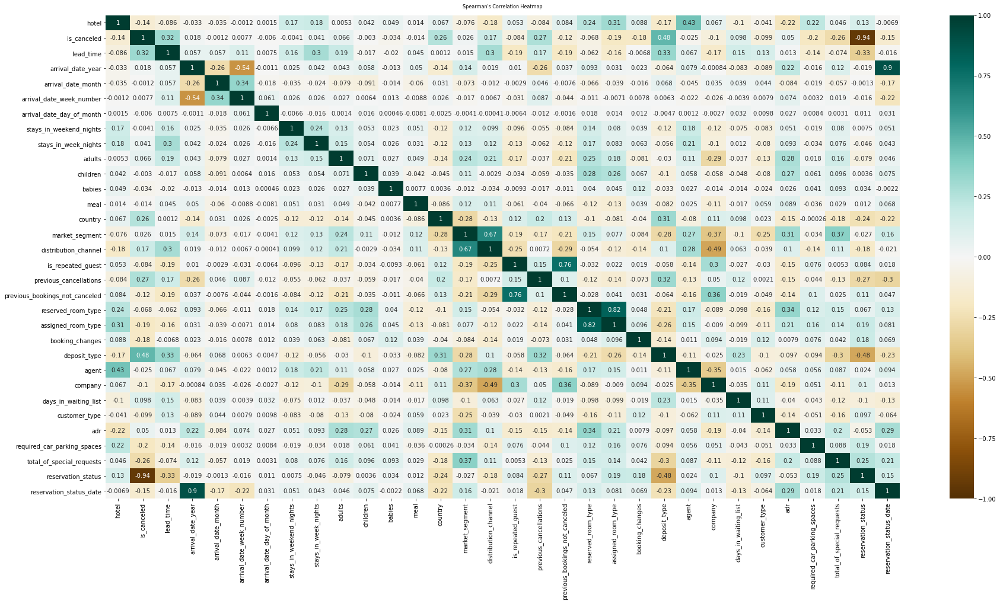

In [25]:
encodeddfcorr_le = encodeddf.corr(method='spearman')

plt.figure(figsize=(30, 15))
heatmap = sns.heatmap(encodeddfcorr_le, vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title("Spearman's Correlation Heatmap", 
                  fontdict={'fontsize':8}, 
                  pad=12)

As an example, there is apparent correlation between the following variables: <br>
is_cancelled WITH adr, deposit type, previous_cancellations, country, lead_time <br>
adr WITH reservation_status_date, total_of_special_requests,reserved_room_type, assigned_room type,market_segment <br>

and many more.

***********

<b> Country Origin of Bookings/Guests

In [32]:
countrydf = pd.DataFrame(dfcopy.loc[dfcopy["is_canceled"] == 0]["country"].value_counts())
countrydf.rename(columns={"country": "Bookings"}, inplace=True)
countrydf.head()

,Bookings
PRT,21071
GBR,9676
FRA,8481
ESP,6391
DEU,6069


In [33]:
countrydf["Guests in %"] = round(countrydf["Bookings"] / 
                                 countrydf["Bookings"].sum() * 100, 2)
countrydf["country"] = countrydf.index
countrydf

,Bookings,Guests in %,country
PRT,21071,28.19,PRT
GBR,9676,12.95,GBR
FRA,8481,11.35,FRA
ESP,6391,8.55,ESP
DEU,6069,8.12,DEU
...,...,...,...
ZMB,1,0.00,ZMB
BFA,1,0.00,BFA
DJI,1,0.00,DJI
SLE,1,0.00,SLE


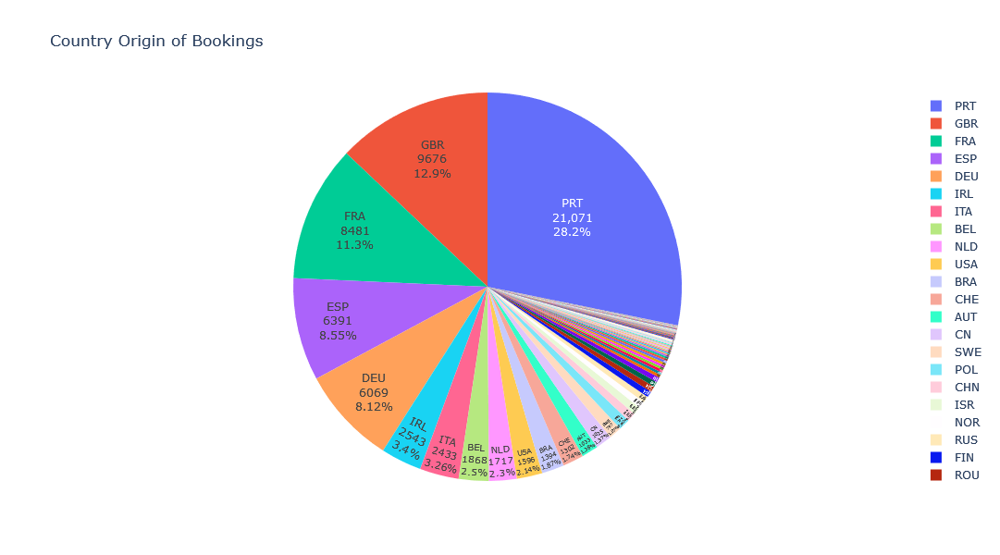

In [39]:
fig = px.pie(countrydf, values="Bookings", names="country", title="Country Origin of Bookings",width=1000, height=600)
fig.update_traces(textposition="inside", textinfo="value+percent+label")

fig.show()

Based on the source paper, the hotel is located in Portugal. This correlates well with how most of the guests are domestic, followed by Great Britain and France.

***********

<b> Room price over the year

In [44]:
montlyavg_price = dfcopy[["hotel", "arrival_date_month", "adr"]].sort_values("arrival_date_month")
montlyavg_price

,hotel,arrival_date_month,adr
87641,City Hotel,April,110.5
87091,City Hotel,April,126.0
87090,City Hotel,April,90.0
87089,City Hotel,April,119.0
87088,City Hotel,April,105.3
...,...,...,...
8398,Resort Hotel,September,68.0
8397,Resort Hotel,September,87.0
8396,Resort Hotel,September,0.0
8404,Resort Hotel,September,80.0


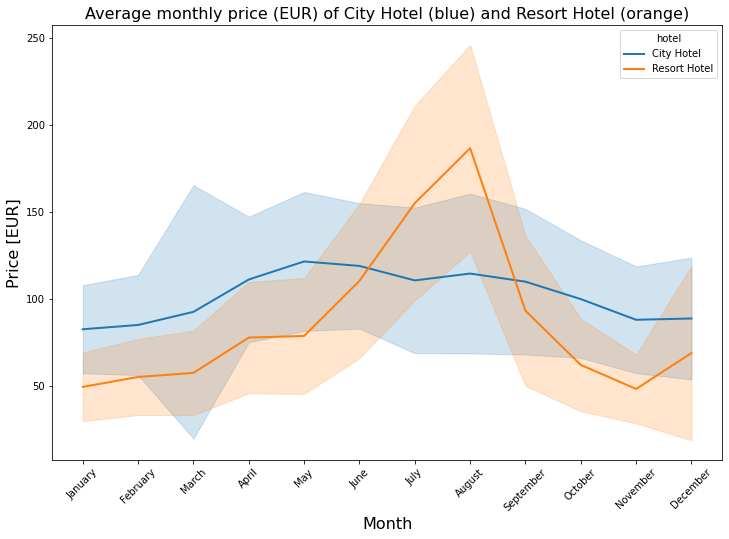

In [46]:
ordered_months = ["January", "February", "March",
                  "April", "May", "June", "July",
                  "August", "September", "October",
                  "November", "December"]

montlyavg_price["arrival_date_month"] = pd.Categorical(montlyavg_price["arrival_date_month"], 
                                                          categories=ordered_months, 
                                                          ordered=True)

plt.figure(figsize=(12, 8))
sns.lineplot(x = "arrival_date_month", y="adr", hue="hotel", 
             data=montlyavg_price, 
            hue_order = ["City Hotel", "Resort Hotel"],
             ci="sd", size="hotel", sizes=(2.0, 2.0))

plt.title("Average monthly price (EUR) of City Hotel (blue) and Resort Hotel (orange)", fontsize=16)
plt.xlabel("Month", fontsize=16)
plt.xticks(rotation=45)
plt.ylabel("Price [EUR]", fontsize=16)
plt.show()

Price for City Hotel is relatively flat across the months, whereas it is apparent that Resort Hotel increases the prices during the summer months.

***********

<b> Booking by market segment (Customer segmentation)

In [48]:
market_seg =dfcopy["market_segment"].value_counts()
market_seg

Online TA        56477
Offline TA/TO    24219
Groups           19811
Direct           12606
Corporate         5295
Complementary      743
Aviation           237
Undefined            2
Name: market_segment, dtype: int64

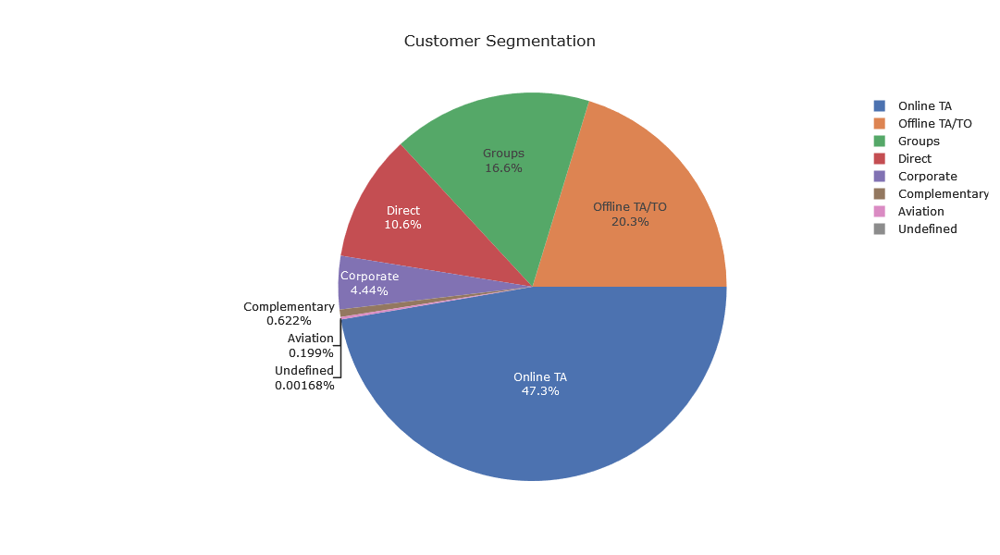

In [51]:
fig = px.pie(market_seg,values=market_seg.values,names=market_seg.index,
             title="Customer Segmentation",
             template="seaborn",width=1000, height=600)
fig.update_traces(rotation=90, textinfo="percent+label")
fig.show()

Given the majority of bookings were done through Online Travel Agent (Online TA, blue), insights like this could possibly allow hoteliers to push more engagement online to solidify their position. 

*****************

<b> Lead Time and Cancellations

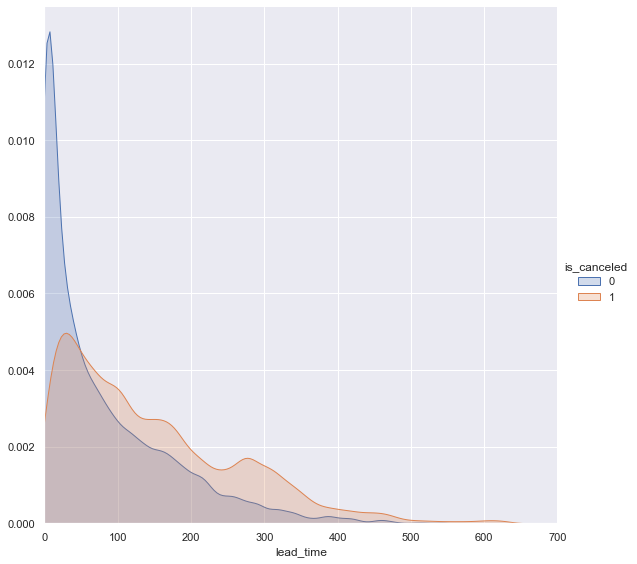

In [61]:
sns.FacetGrid(dfcopy, hue = 'is_canceled',
             height = 8, xlim = (0,700)).map(sns.kdeplot, 'lead_time', shade = True).add_legend()

From this distribution (kdeplot) of lead_time in regards to cancellations, cancellations tend to happen with higher probability when the lead_time is more than about 50 (days). This could benefit hoteliers if they are keen of the idea of over-booking. They could assume that bookings more than X amount of days could lead to cancellations, thus opening a door to allow for overlapping bookings. This will be explored more in the prediction model later.

***********

<b> Cancellations by Segment

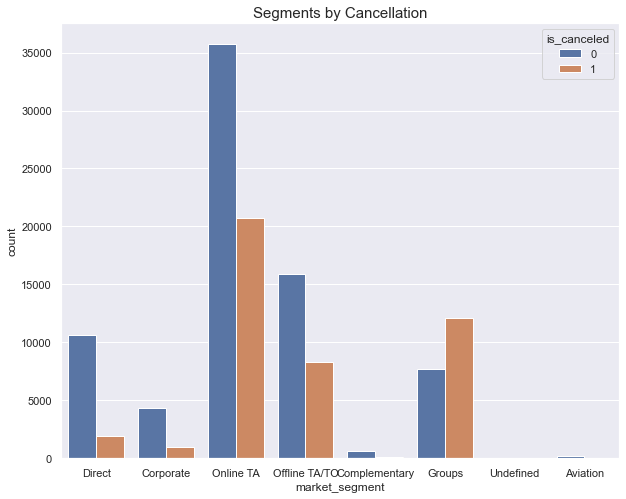

In [58]:
plt.figure(figsize = (10,8))
sns.set(style = "darkgrid")
plt.title("Segments by Cancellation", fontdict = {'fontsize':15})
ax = sns.countplot(x = "market_segment", hue = 'is_canceled', data = dfcopy)

Eventhough Online TA leads in terms of being where most the bookings come from, it is also relatively the highest among all the other segments. Aviation segment maintains a very low cancellation rate, this maybe due to their bookings are for the crew, hence rarely cancelled.

[Home](#home)

***********************************

<a name='predcel'> </a>
## <b> Booking Cancellation Prediction (PredCel)

*Nature of case study: Classification*
<br>
<br>
This segment covers the prediction of booking cancellation using machine learning methods. Before proceeding to any modelling, some additional data prep is necessary for this specific dataset. In this particular case, feature selection is done to reduce the number of inputs (reduce computational cost) as well as removing highly dependant variables amongst the input variables (high multicollinearity).

Dataframe used: "encodeddf". <br>

In [67]:
encodeddf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  int32  
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  int32  
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

************

<b> Feature Selection/Importance

In this code block, the input being all the variables is trained to the label (is_canceled), as the purpose of this model is to be able to predict cancellations. By using SelectKBest, the function will evaluate and rank which feature/variable is most important (highest weightage) in deteremining a proper outcome.

In [76]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2, f_classif

#variables
X = encodeddf.loc[:, encodeddf.columns != 'is_canceled']
#target
y = encodeddf.iloc[:,1]

bestfeatures = SelectKBest(score_func=f_classif, k=5)
fit = bestfeatures.fit(X,y)

dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)

In [77]:
featureScores = pd.concat([dfcolumns, dfscores], axis=1)
featureScores.columns = ['Feature Name', 'Score']

print(featureScores.nlargest(10,'Score'))

                   Feature Name          Score
29           reservation_status  631531.482310
21                 deposit_type   33555.541929
1                     lead_time   11184.572883
12                      country    9019.776940
28    total_of_special_requests    6960.355764
27  required_car_parking_spaces    4747.373627
19           assigned_room_type    3803.611518
14         distribution_channel    3449.829292
30      reservation_status_date    3220.090421
20              booking_changes    2554.104007


************

Based on this, the top 5 variable that is considered as highly valuable is: <br>
1. reservation_status <br>
2. deposit_type <br>
3. lead_time <br>
4. total_of_special_requests <br>
5. required_car_parking_spaces <br>

<br>
However, it is not preferable to select reservation status to be part of the inputs as it is counter-intuitive to leak the data of cancellations when the model is used to predict cancellations. This is backed by the level of correlation in the previous correlation heatmap, which indicates a very high collinearity between reservation_status and is_canceled (-0.94). <br>
<br>
Thus, the assigned_room_type will be included instead.

****************

<b> Base Models & Evaluations

In [81]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier

from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score

In [83]:
#indepenent cols
X = encodeddf.loc[:, ['deposit_type','lead_time','country', 'total_of_special_requests','assigned_room_type']]
#depenent cols
y = encodeddf.iloc[:,1]

#split
#from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
#scaler = MinMaxScaler()

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, shuffle=True)

#X_train = scaler.fit_transform(X_train)
#X_test = scaler.fit_transform(X_test)

print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(83447, 5)
(35763, 5)
(83447,)
(35763,)


In [85]:
%%time
models = []

models.append(("RandomForestClassifier",RandomForestClassifier()))
models.append(("SVC",SVC(random_state=42)))
models.append(("SGDClassifier",SGDClassifier(random_state=42)))
models.append(("DecisionTreeClassifier",DecisionTreeClassifier(random_state=42)))
models.append(("MLPClassifier", MLPClassifier(random_state=42)))
models.append(("XGBClassifier", XGBClassifier(random_state=42)))

###
results = []
names = []

#with cv
for name,model in models:
    result = cross_val_score(model, X_train, y_train,  cv=5, scoring = 'accuracy')
    names.append(name)
    results.append(result)
    
# for name,model in models:
#     model.fit(X_train, y_train)
#     result = model.score(X_train, y_train)
#     names.append(name)
#     results.append(result)

    
for i in range(len(names)):
    print(names[i],results[i].mean())

C:\Users\luqma\anaconda3\envs\tfgpu2\lib\site-packages\xgboost\sklearn.py:1224: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[17:54:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\luqma\anaconda3\envs\tfgpu2\lib\site-packages\xgboost\sklearn.py:1224: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[17:54:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\luqma\anaconda3\envs\tfgpu2\lib\site-packages\xgboost\sklearn.py:1224: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[17:54:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\luqma\anaconda3\envs\tfgpu2\lib\site-packages\xgboost\sklearn.py:1224: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[17:54:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\luqma\anaconda3\envs\tfgpu2\lib\site-packages\xgboost\sklearn.py:1224: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[17:54:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
RandomForestClassifier 0.782508703526011
SVC 0.7429627053493075
SGDClassifier 0.6550495041258255
DecisionTreeClassifier 0.7783743370462369
MLPClassifier 0.7623163968071879
XGBClassifier 0.7944204477204859
Wall time: 18min 20s


In [86]:
%%time

resultsacc = []
names2 = []
pred = []

for name, model in models:
    alg = model
    alg.fit(X_train, y_train)
    y_pred = alg.predict(X_test)
    pred.append(y_pred)
    
    result = accuracy_score(y_test,y_pred)
    resultsacc.append(result)
    
    names2.append(name)
    
    
for i in range (len(names2)):
    print(names2[i], 
          "|| Accuracy Score:" ,resultsacc[i])

C:\Users\luqma\anaconda3\envs\tfgpu2\lib\site-packages\xgboost\sklearn.py:1224: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[18:01:13] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
RandomForestClassifier || Accuracy Score: 0.7882727959063837
SVC || Accuracy Score: 0.7464977770321282
SGDClassifier || Accuracy Score: 0.7426949640690099
DecisionTreeClassifier || Accuracy Score: 0.7851690294438386
MLPClassifier || Accuracy Score: 0.7509157509157509
XGBClassifier || Accuracy Score: 0.797584095294019
Wall time: 6min 44s


************

<b> Model Tuning & Optimizations

Tuning was done by implementing GridSearchCV to run through mulitple instances of hyperparameter values to achieve a better performing model.

In [87]:
from sklearn.model_selection import GridSearchCV

In [90]:
gscvxgb = GridSearchCV(estimator= XGBClassifier(), 
                    param_grid= {'max_depth': (2,5,10,20), 
                                 'gamma': (0.0,0.1),
                                 'subsample': (0.75,0.9),
                                 'colsample_bytree': (0.75,0.9),
                                'alpha': (0,0.1,0.2),
                                'sampling_method':('uniform', 'gradient_based'),
                                'eta': (0.01, 0.05, 0.1),
                                'min_child_weight': (1,2),
                                'lambda':(0.25,0.5,1)},
                    cv= 5,
                    scoring='accuracy', 
                    verbose=0, 
                    n_jobs=-2
                   )

In [91]:
grid_result = gscvxgb.fit(X_train, y_train)

best_params = grid_result.best_params_
best_params

C:\Users\luqma\anaconda3\envs\tfgpu2\lib\site-packages\sklearn\model_selection\_search.py:922: UserWarning:

One or more of the test scores are non-finite: [0.74990116 0.74990116 0.74990116 ...        nan        nan        nan]

C:\Users\luqma\anaconda3\envs\tfgpu2\lib\site-packages\xgboost\sklearn.py:1224: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[19:57:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


{'alpha': 0.2,
 'colsample_bytree': 0.75,
 'eta': 0.05,
 'gamma': 0.0,
 'lambda': 0.25,
 'max_depth': 20,
 'min_child_weight': 1,
 'sampling_method': 'uniform',
 'subsample': 0.9}

{'alpha': 0.2,
 'colsample_bytree': 0.75,
 'eta': 0.05,
 'gamma': 0.0,
 'lambda': 0.25,
 'max_depth': 20,
 'min_child_weight': 1,
 'sampling_method': 'uniform',
 'subsample': 0.9}

In [92]:
xgb_cl = XGBClassifier(n_estimators = 1000,
                            max_depth= best_params['max_depth'],
                            gamma = best_params['gamma'],
                            subsample= best_params['subsample'],
                            colsample_bytree= best_params['colsample_bytree'],
                            alpha= best_params['alpha'],
                            sampling_method=best_params['sampling_method'],
                            eta=best_params['eta'],
                            min_child_weight=best_params['min_child_weight'],
                            reg_lambda = best_params['lambda'],
                            random_state=42)
xgb_cl.fit(X_train, y_train)

print("Accuracy on training set: {:.2f}%".format(xgb_cl.score(X_train, y_train)*100))
print("Accuracy on test set: {:.2f}%".format(xgb_cl.score(X_test, y_test)*100))

[19:57:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy on training set: 87.40%
Accuracy on test set: 79.52%


In [93]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred, labels=[0,1]))

              precision    recall  f1-score   support

           0       0.79      0.93      0.85     22461
           1       0.83      0.58      0.68     13302

    accuracy                           0.80     35763
   macro avg       0.81      0.75      0.77     35763
weighted avg       0.80      0.80      0.79     35763



In [94]:
pred2 = xgb_cl.predict(X_test)
accuracy_score(y_test, pred2)

0.7951514134720241

Text(30.5, 0.5, 'Actual')

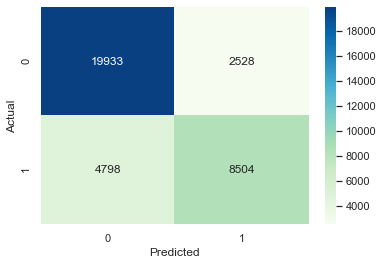

In [95]:
from sklearn.metrics import confusion_matrix
c_matrix2 = confusion_matrix(y_test, pred2)

sns.heatmap(pd.DataFrame(c_matrix2), cmap = "GnBu", annot = True, fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')

Confusion matrix visualizes the prediction against the actual. In this case, "0" being not cancelled, and "1" being cancelled. the prediction model is capable of predicting 19933 instances of non-cancellations with 4798 errors. The model is also able to predict cancellations upto 8504 instances correctly with 2528 errors.

***************

<b> Fit on whole dataset and Save model.

In [96]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
import warnings
warnings.filterwarnings("ignore")

kf = KFold(n_splits=5, shuffle=True, random_state=42)
acc= cross_val_score(xgb_cl, X, y, scoring="accuracy", cv = kf)
print(abs(acc.mean()))

[20:04:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:05:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:06:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:07:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

*************************

After optimizations, the model was able to increase significantly on its training dataset from 79.75% to 87.40%, but at the expense of some minimal loss on the testing set, from 79.76% to 79.56% <br>

Based on the Classification Report, the model overall was able to gain 80.00% in terms of accurcay.

In [ ]:
###
# import pickle
# filename = 'predcelmodel1.sav'
# pickle.dump(model1_f, open(filename, 'wb'))

[Home](#home)

## <b> *****************************************************************************

<a name='predbook'> </a>
## <b> Nights Booked Predictor (PredBook)

*Nature of case study: Regression*
<br>
<br>
This model is aimed to predict the number of nights booked for each booking. This model would help hoteliers gain insight on an expected range of days that would be booked based on several input features. By having this edge, hoteliers can maximize promotion to entice long bookings and even increase the chances for longer bookings during low booking numbers with lower room rates.

Dataframe used: "noncanceldf". <br>
The dataframe excludes cancelled bookings as it is not necessary in creating a model to predict number of nights that were booked.

In [97]:
noncanceldf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 75011 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   hotel                           75011 non-null  int32  
 1   is_canceled                     75011 non-null  int64  
 2   lead_time                       75011 non-null  int64  
 3   arrival_date_year               75011 non-null  int64  
 4   arrival_date_month              75011 non-null  int32  
 5   arrival_date_week_number        75011 non-null  int64  
 6   arrival_date_day_of_month       75011 non-null  int64  
 7   stays_in_weekend_nights         75011 non-null  int64  
 8   stays_in_week_nights            75011 non-null  int64  
 9   adults                          75011 non-null  int64  
 10  children                        75011 non-null  float64
 11  babies                          75011 non-null  int64  
 12  meal                           

In [98]:
noncanceldf['totalnights'] = noncanceldf['stays_in_weekend_nights'] + noncanceldf['stays_in_week_nights']
noncanceldf['totalnights']

0         0
1         0
2         1
3         1
4         2
         ..
119385    7
119386    7
119387    7
119388    7
119389    9
Name: totalnights, Length: 75011, dtype: int64

**********

<b> Feature Selection/Importance

In [101]:
from sklearn.feature_selection import f_regression

#variables
X = noncanceldf.drop(['stays_in_weekend_nights', 'stays_in_week_nights','totalnights'],
            axis=1)
#target
y = noncanceldf['totalnights']

bestfeatures = SelectKBest(score_func=f_regression, k=5)
fit = bestfeatures.fit(X,y)

dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)

In [102]:
featureScores = pd.concat([dfcolumns, dfscores], axis=1)
featureScores.columns = ['Feature Name', 'Score']

print(featureScores.nlargest(10,'Score'))

            Feature Name        Score
2              lead_time  6744.406007
0                  hotel  4328.155550
21                 agent  2978.263218
24         customer_type  2578.001921
17    reserved_room_type  2222.359988
11               country  2178.503539
7                 adults  1906.109889
13  distribution_channel  1316.704793
14     is_repeated_guest  1192.413268
12        market_segment   875.325925


******

From this, it is clear that the lead_time plays a huge role in determining the number of nights that would be booked. For the model, 5 of the highest weighted features will be used. The features are:<br>
1. lead_time<br>
2. hotel<br>
3. agent<br>
4. customer_type<br>
5. reserved_room_type

**********

<b> Base Models & Evaluations

In [104]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import SGDRegressor
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import Lasso

from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import StackingRegressor

from sklearn.neural_network import MLPRegressor
from xgboost import XGBRegressor

from math import sqrt
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [105]:
X = noncanceldf.iloc[:, [2,0,21,24,17]]
#output
y = noncanceldf['totalnights']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state= 42, shuffle=True)

In [106]:
%%time
models = []

models.append(("LinearRegression",LinearRegression()))
models.append(("Ridge",Ridge(random_state=42)))
models.append(("RidgeCV",RidgeCV()))
models.append(("SGDRegressor",SGDRegressor(random_state=42)))
models.append(("ElasticNet",ElasticNet(random_state=42)))
models.append(("Lasso",Lasso(random_state=42)))

models.append(("RandomForest",RandomForestRegressor(random_state=42)))
models.append(("GradientBoostingRegressor",GradientBoostingRegressor(random_state=42)))

models.append(("MLPRegressor", MLPRegressor(random_state=42)))

models.append(("XGBRegressor", XGBRegressor()))

###
results = []
names = []
for name,model in models:
    result = -cross_val_score(model, X_train, y_train.values.ravel(),  cv=5, scoring = 'neg_root_mean_squared_error')
    names.append(name)
    results.append(result)

for i in range(len(names)):
    print(names[i],results[i].mean())

LinearRegression 2.375596661885502
Ridge 2.375596630903966
RidgeCV 2.3755964303143355
SGDRegressor 3704102618662.4
ElasticNet 2.461446424652377
Lasso 2.461496062680313
RandomForest 2.1633832042334786
GradientBoostingRegressor 2.170169555299915
MLPRegressor 2.247367571084427
XGBRegressor 2.127579982581719
Wall time: 44.5 s


In [107]:
%%time

#resultsr2 = []
resultsrmse = []
names2 = []
pred = []

for name, model in models:
    alg = model
    alg.fit(X_train, y_train.values.ravel())
    y_pred = alg.predict(X_test)
    y_pred=np.rint(y_pred)
    pred.append(y_pred)
    
    #result = r2_score(y_test.values.ravel(),y_pred)
    #resultsr2.append(result)
    
    result = -cross_val_score(model, X_test, y_test.values.ravel(),  cv=5, scoring = 'neg_root_mean_squared_error').mean()
    resultsrmse.append(result)
    
    names2.append(name)
    
    
for i in range (len(names2)):
    print(i,names2[i], 
          #"|| R2 Score:" ,resultsr2[i], 
          "| RMSE Score:", resultsrmse[i])

0 LinearRegression | RMSE Score: 2.3062055652524105
1 Ridge | RMSE Score: 2.306205508585992
2 RidgeCV | RMSE Score: 2.3062054004683845
3 SGDRegressor | RMSE Score: 4651886395600.513
4 ElasticNet | RMSE Score: 2.390364700864732
5 Lasso | RMSE Score: 2.3904258309546007
6 RandomForest | RMSE Score: 2.171196336213251
7 GradientBoostingRegressor | RMSE Score: 2.1185494553802755
8 MLPRegressor | RMSE Score: 2.155859157993048
9 XGBRegressor | RMSE Score: 2.102289510638755
Wall time: 29.9 s


****************

From the base models (training and testing set), XGBRegressor outperforms all the other algorithm by having the lowest RMSE score.

***********

In [108]:
preddf = pd.DataFrame(pred[9], columns= ['Predicted'])

preddf = preddf
testdf = y_test.reset_index()
testdf.columns = testdf.columns.str.replace('totalnights', 'Actual')

In [109]:
combdf = pd.concat([preddf, testdf], axis=1)
combdf = combdf.iloc[:, [0,2]]
combdf

,Predicted,Actual
0,3.0,3
1,3.0,1
2,2.0,2
3,2.0,1
4,1.0,0
...,...,...
22499,4.0,2
22500,3.0,1
22501,4.0,3
22502,2.0,1


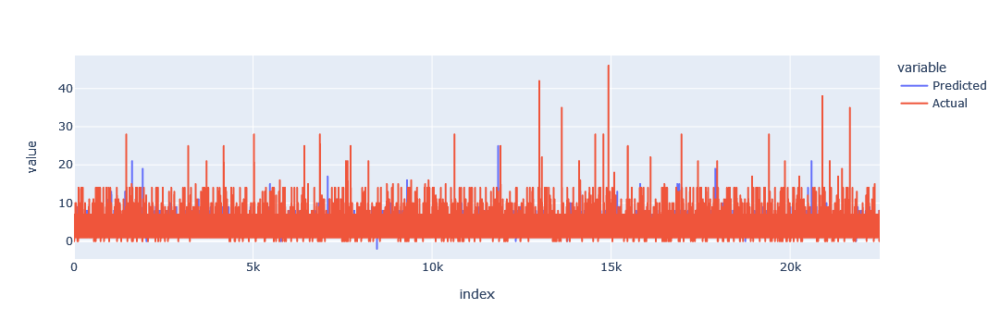

In [110]:
px.line(combdf)

In [111]:
y_test.std()

2.5032450534977104

The trend line shows how the model is able to capture the number of nights with an average variance of error of about 2.1 days. This still falls within the standard deviation of 2.5. Being within the std deviation indicates a decent generalization on the data.

***********

<b> Model Tuning & Optimizations

XGBRegressor was chosen to be further optimized and tuned as it is the most performing based on the base models earlier.

Further optimizations can be done by tuning the hyperparameters to fit better. Outliers/extreme values were left undisturbed as ensemble based models are robust towards outliers. Optimization was done by using GridSearchCV which evaluates performances across a multitude of hyperparameter values, in search of the best combination.

In [112]:
gscv3 = GridSearchCV(estimator=XGBRegressor(), 
                    param_grid= {'n_estimators': (500,1000,1500),
                                 'subsample': (0.75,0.9),
                                 'colsample_bytree': (0.75,0.9),
                                'eta': (0.05, 0.1),
                                'lambda':(0.75,1)
                                },
                    cv= 5,
                    scoring= 'neg_root_mean_squared_error', 
                    verbose=-1, 
                    n_jobs=-1,
                   )

grid_result2 = gscv3.fit(X_train, y_train.values.ravel())
best_params2 = grid_result2.best_params_
best_params2

In [113]:
xgb_reg= XGBRegressor(n_estimators = best_params2['n_estimators'],
                            subsample = best_params2['subsample'],
                            colsample_bytree = best_params2['colsample_bytree'],
                            eta= best_params2['eta'],
                            reg_lambda= best_params2['lambda'],
                           random_state=42)

In [114]:
regr2 = xgb_reg.fit(X_train, y_train.values.ravel())
y_pred = regr2.predict(X_test)

print('Mean Absolute Error:', mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', sqrt(mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 1.3814092713477368
Mean Squared Error: 4.292291604602432
Root Mean Squared Error: 2.0717846424284625


The performance of the model slightly improves from a RMSE of 2.10 to 2.07.

In [115]:
y_pred3 = regr2.predict(X_test)

preddf = pd.DataFrame(np.rint(y_pred3), columns= ['Predicted'])
y_test = pd.DataFrame(y_test)
testdf = y_test.reset_index(drop=True).rename(columns={'totalnights': 'Actual'})

combdf2 = pd.concat([preddf, testdf], axis=1)
combdf2

,Predicted,Actual
0,4.0,3
1,3.0,1
2,2.0,2
3,2.0,1
4,1.0,0
...,...,...
22499,4.0,2
22500,3.0,1
22501,4.0,3
22502,2.0,1


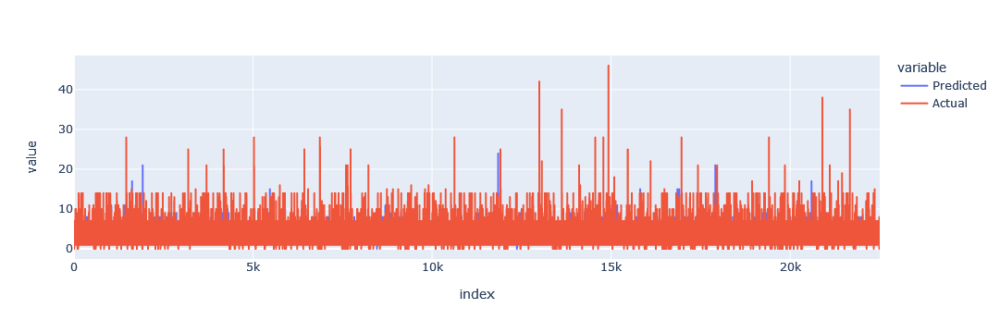

In [116]:
px.line(combdf2)

[Home](#home)

********

<b> Fit on whole dataset and Save model.

In [119]:
##
kf = KFold(n_splits=10, shuffle=True, random_state=42)
rmse= np.sqrt(-cross_val_score(xgb_reg, X, y.values.ravel(), scoring="neg_mean_squared_error", cv = kf))
print(abs(rmse.mean()))

2.098145063651766


In [ ]:
###
# import pickle
# filename = 'whenmodel.sav'
# pickle.dump(model1_f, open(filename, 'wb'))

**********

<a name='wrap'> </a>
## <b> Wrap-up

Workflow:<br>
1. Understanding the case study and what kind of problem it is. In the case of PredCel (predict cancellations), its a classification problem as the label is categorical (cancellation YES or NO, or in this case 1 or 0). This includes understanding some jargons and domain knowledge to get a grasp of what each variable is so that we can pinpoint conflicting variables  that would hinder the model.
2. Finding trends, correlation, and patterns. For Predbook (prediction of number of nights booked), its a regression problem as value(s) to be predicted are of a continuous value.
3. Prep the data before modelling.
4. Identify important features to reduce number of features.
5. Attempt multiple base models to seek the best algorithm. Models are then evaluated (accuracy or rmse).
6. Attempt to optimize and tune to improve performance of the best performing model.
7. Evaluate final model (accuracy or rmse).
8. (optional) fit the whole dataset to the model and save the model.
<br>

***********

### <b>PredCel

Predicting Cancellations <br>
Using XGBClassifier, the model was able to predict cancellations rate accurately at xx.xx%. A model as such could highly benefit the hotel industry by allowing them to maximize bookings by using methods by the airline industry, by overlapping or overbooking these bookings. On the other hand, it also would help the management to consider enforcing no refunds or deposit policy of a certain amount to retain bookings with loss of business. The model can be further enhanced by fitting the data with a larger range of hyperparameter values so that a better fit can be found.<br>
<br>


XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX<br>
Algorithm: XGB Classifier (Tuned) <br>
X variables (inputs): reservation_status,deposit_type,lead_time,total_of_special_requests, required_car_parking_spaces<br>
y variable (target): is_cancel <br>
Achieved Accuracy: 80.00% <br>
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

*************

### <b>PredBook

Based on XGBRegressor, the model was able to predict the number of nights that would be booked based on the given inputs(X) with a root mean squared error (RMSE) of 2.07. This indicates a reasonably small margin or variance of error as it falss within the standard deviation of the data, about 2.5days, hence a generalized model can assumed to be achieved. Further improvements can be extensively be done by putting a larger range for the hyperparameter tuning and more robust data prep methods (consider outlier removal, normalizations, etc). <br>
<br>


XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX<br>
Algorithm: XGB Regressor (Tuned)<br>
X variables (inputs): lead_time,hotel,agent,customer_type,reserved_room_type <br>
y variable (target): totalnights <br>
Achieved RMSE: 2.07 days <br>
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

**********

### <b> Data Science use cases for Hoteliers

Based on the dataset, hoteliers could benefit alot on multiple angles. The main value from this data is understanding the market/customer segmentation, timing for price hikes, and mitigation of loss of revenue.<br>
Customer segmentation allows hoteliers to pinpoint and create "targeted" advertisement or promotion to certain groups. For example, given that most of their customers are locals (country origin: Portugal), they could make use of special holidays/celebrations to create promotions on the rooms. Meals could also cater more to the local taste bud to entice locals to stay for longer days.

### <b> Data Science use cases for Guests

Use case for guests is mainly in finding the best pricing for booking a room. Algorithms could be made to predict the next price hike or slump before making a decision. This could be done by approaching the data in a time series manner and use forecasting approaches to find an optimal time to book a room. <br>
There is also a possibility to create a model that could help find the cheapest market segment method to lock in the best price for the same room type (correlation  between market segment and average daily rate (adr)).

[Home](#home)

*****

END.

******